#**Importing the Required Libraries**

In [ ]:
#Importing  os to create a helper variable, which allows us to easily manages different paths in the code
import os


In [ ]:
#glob is used to return all file paths that match a specific pattern.
import glob

In [ ]:
# If we want to display a single image, then "Image" Library is fine, but if we want to display multiple images by just running a single cell
# then we need to import display

from IPython.display import Image, display

In [ ]:
# To clear output in the notebook use clear_output function
#display.clear_output()

# **In the First Step, We need to check whether we have access to the GPU or not**

In [ ]:
!nvidia-smi

Wed Sep 13 11:30:55 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
HOME = os.getcwd()

In [ ]:
print(HOME)

/content


#**Installing Ultralytics using Pip Install**

#**YOLOv8 can be installed in two ways - from the source and via pip. This is because it is the first iteration of YOLO to have an official package.**

In [ ]:
# Git clone method (for development)

# %cd {HOME}
# !git clone github.com/ultralytics/ultralytics
# %cd {HOME}/ultralytics
# !pip install -qe ultralytics

# from IPython import display
# display.clear_output()

# import ultralytics
# ultralytics.checks()

In [ ]:
# !pip install ultralytics==8.0.0



In [ ]:
!git clone https://github.com/MuhammadMoin97/ultralytics.git

#**Setting the Current Directory**

In [ ]:
%cd {HOME}/ultralytics

/content/ultralytics


#**Installing all the Dependencies**

In [ ]:
!pip install -e '.[dev]'

Obtaining file:///content/ultralytics
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.5/189.5 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 229.1/229.1 kB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.7/3.7 MB 69.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 71.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 14.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 83.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 9.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

##Checking whether YOLOv8 is Installed and its working Fine

In [ ]:
import ultralytics

In [ ]:
ultralytics.checks()

Ultralytics YOLOv8.0.0 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.6/78.2 GB disk)


#**Importing the Helmets Segmentation Dataset from Roboflow**

In [ ]:
HOME = '/content/ultralytics/ultralytics/yolo/v8/segment'

In [ ]:
%cd  '/content/ultralytics/ultralytics/yolo/v8/segment'

/content/ultralytics/ultralytics/yolo/v8/segment


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="3R4CXqlkFcXvEWkrj52E")
project = rf.workspace("politeknik-elektronika-negeri-surabaya-v8wa8").project("helm-people")
dataset = project.version(1).download("yolov5")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Helm-people-1 in yolov5pytorch:: 100%|██████████| 708/708 [00:00<00:00, 5651.68it/s]


#**Train the YOLOv8 Model on the Custom Dataset**

In [ ]:
%cd {HOME}

/content/ultralytics/ultralytics/yolo/v8/segment


In [ ]:
dataset.location  = '/content/ultralytics/ultralytics/yolo/v8/segment/Helm-people'

In [ ]:
%cd {dataset.location}

/content/ultralytics/ultralytics/yolo/v8/segment/Helm-people


In [ ]:
!rm -rf ultralytics

In [ ]:
%cd {HOME}

!python train.py model=yolov8l-seg.pt data=/content/Helm-people/data.yaml epochs=80 imgsz=640

/content
python3: can't open file '/content/train.py': [Errno 2] No such file or directory


In [ ]:
!ls {HOME}/runs/segment/train4

args.yaml					    results.csv
BoxF1_curve.png					    results.png
BoxP_curve.png					    train_batch0.jpg
BoxPR_curve.png					    train_batch1190.jpg
BoxR_curve.png					    train_batch1191.jpg
confusion_matrix.png				    train_batch1192.jpg
events.out.tfevents.1676616071.39dc3a723b43.3183.0  train_batch1.jpg
MaskF1_curve.png				    train_batch2.jpg
MaskP_curve.png					    val_batch0_labels.jpg
MaskPR_curve.png				    val_batch0_pred.jpg
MaskR_curve.png					    weights
predictions.json


#**Displaying the Confusion Matrix**

/content/ultralytics/ultralytics/yolo/v8/segment


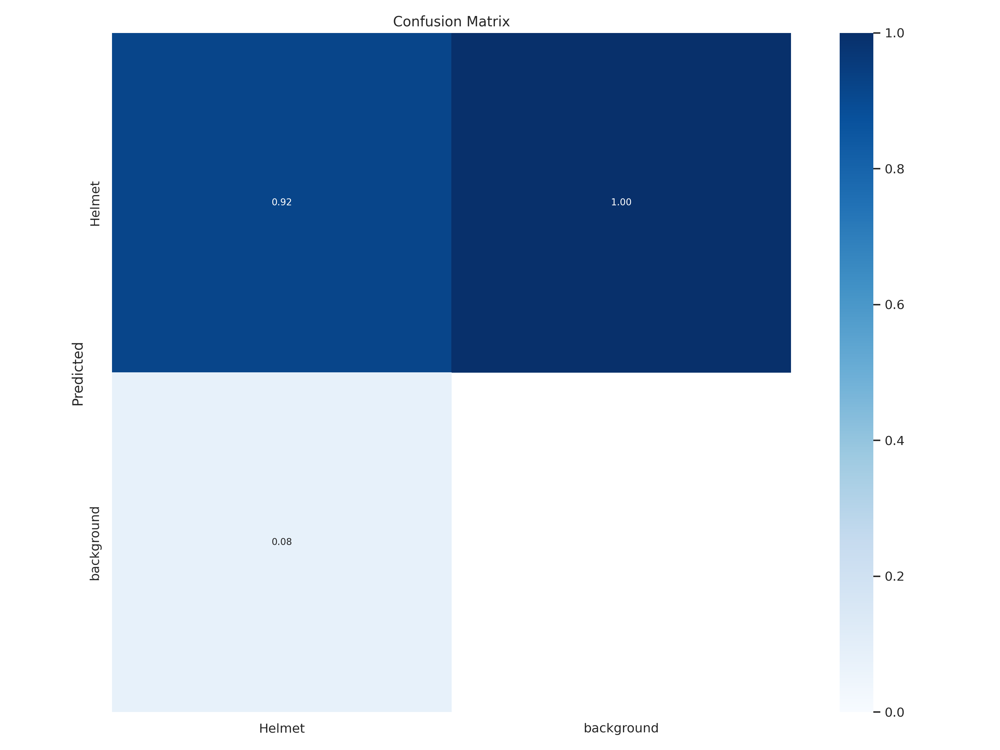

In [ ]:
#Confusion matrix is the chart that shows how our model handles different classes
#92% of the time the model detected correctly that the person is wearing the helmet,  while 1% of the time when the person is wearing the helmet
#the model is unable to detect it
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train4/confusion_matrix.png', width=900)

#**Training and Validation Loss**

/content/ultralytics/ultralytics/yolo/v8/segment


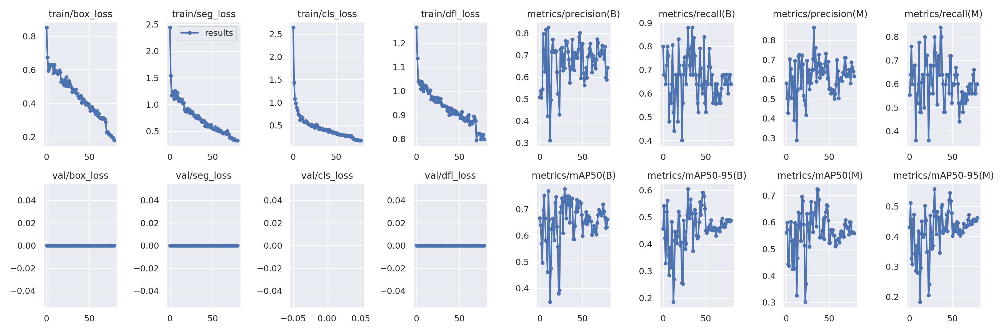

In [ ]:
# Here is the graph of the training and validation loss
#box loss and class loss is important
# The behavior of the model is convincing the model is coverging, Training more will give better results
%cd {HOME}

Image(filename=f'{HOME}/runs/segment/train4/results.png', width=600)

/content/ultralytics/ultralytics/yolo/v8/segment


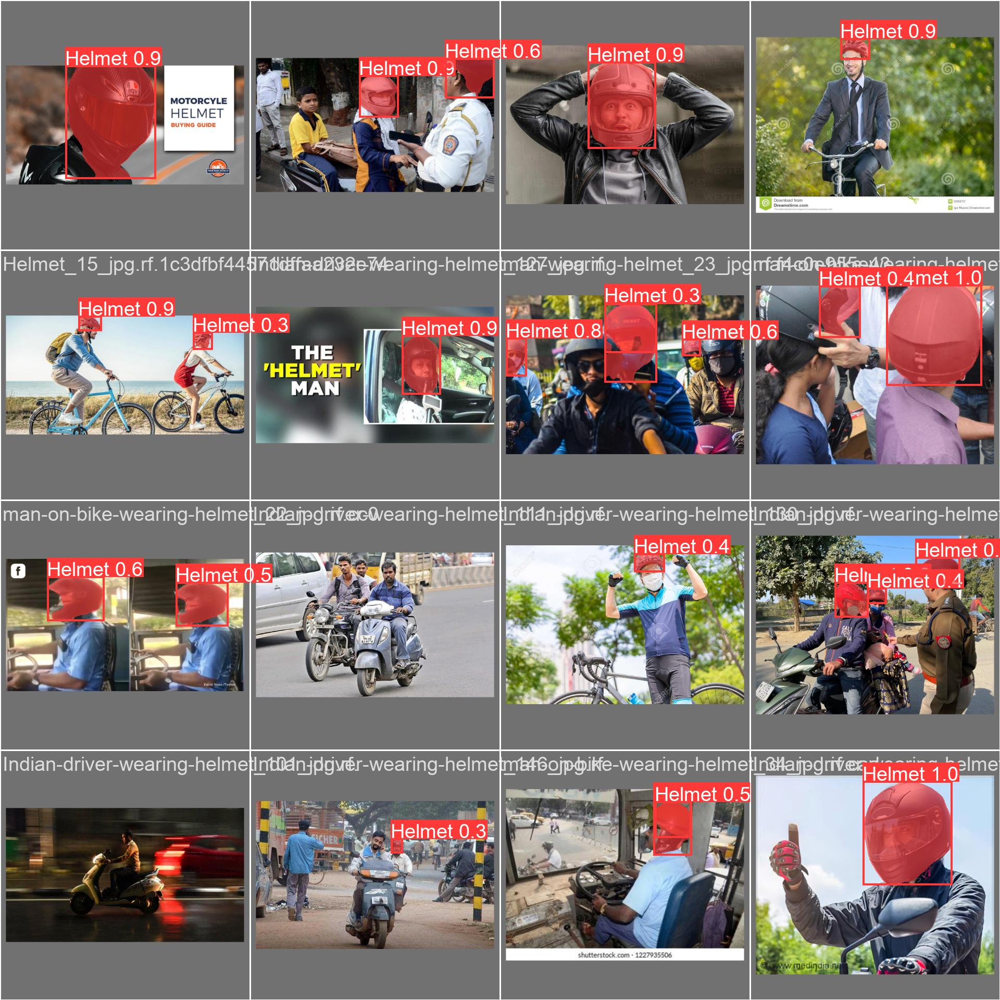

In [ ]:
#Model Prediction on validation batch. These image are not used strictly for training so it is always better to take a
#look and see how model is behaving
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train4/val_batch0_pred.jpg', width=600)

#**Validate Custom Model**

In [ ]:
#Here, we are taking the model best weights and using them to validate the model

%cd {HOME}

!python val.py model='{HOME}/runs/segment/train4/weights/best.pt' data={dataset.location}/data.yaml

/content/ultralytics/ultralytics/yolo/v8/segment
Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
YOLOv8l-seg summary: 295 layers, 45912659 parameters, 0 gradients, 220.1 GFLOPs
val: Scanning /content/ultralytics/ultralytics/yolo/v8/segment/Helmet/val/labels.cache... 24 images, 1 backgrounds, 0 corrupt: 100% 24/24 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 2/2 [00:02<00:00,  1.15s/it]
                   all         24         25      0.632      0.825      0.774      0.614      0.603       0.79      0.699      0.562
Speed: 0.2ms pre-process, 44.3ms inference, 0.0ms loss, 1.0ms post-process per image


#**Testing on a Demo Video**

#**Display the Demo Video**

#**Downloading the Demo Video2**

In [ ]:
!gdown "https://drive.google.com/uc?id=1Q2tEqmTACa84EXGIiJitrCkoI_VlzjMH&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1Q2tEqmTACa84EXGIiJitrCkoI_VlzjMH&confirm=t
To: /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4
100% 50.5M/50.5M [00:00<00:00, 233MB/s]


#**Testing on the Demo Video**

In [ ]:
%cd {HOME}

!python predict.py model='{HOME}/runs/segment/train4/weights/best.pt' source='newbike.mp4'

/content/ultralytics/ultralytics/yolo/v8/segment
Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
YOLOv8l-seg summary: 295 layers, 45912659 parameters, 0 gradients, 220.1 GFLOPs
video 1/1 (1/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 1 Helmet, 50.9ms
video 1/1 (2/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 1 Helmet, 49.3ms
video 1/1 (3/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 2 Helmets, 49.4ms
video 1/1 (4/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 2 Helmets, 49.4ms
video 1/1 (5/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 1 Helmet, 49.4ms
video 1/1 (6/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 1 Helmet, 49.3ms
video 1/1 (7/170) /content/ultralytics/ultralytics/yolo/v8/segment/newbike.mp4: 384x640 1 Helmet, 49.4ms
video 1/1 (8/170) /content/ult

#**Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/ultralytics/ultralytics/yolo/v8/segment/runs/detect/train2/newbike.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Downloading the Demo Video3**

In [ ]:
!gdown "https://drive.google.com/uc?id=1GmMs8uNLBRyY-TsViLyjNs3M2ut8I0ej&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1GmMs8uNLBRyY-TsViLyjNs3M2ut8I0ej&confirm=t
To: /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4
100% 5.46M/5.46M [00:00<00:00, 38.4MB/s]


#**Testing on the Demo Video**

In [ ]:
%cd {HOME}

!python predict.py model='{HOME}/runs/segment/train4/weights/best.pt' source='bike2.mp4'

/content/ultralytics/ultralytics/yolo/v8/segment
Ultralytics YOLOv8.0.3 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)
Fusing layers... 
YOLOv8l-seg summary: 295 layers, 45912659 parameters, 0 gradients, 220.1 GFLOPs
video 1/1 (1/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 1 Helmet, 49.9ms
video 1/1 (2/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 49.2ms
video 1/1 (3/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 1 Helmet, 42.8ms
video 1/1 (4/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 42.1ms
video 1/1 (5/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 1 Helmet, 42.1ms
video 1/1 (6/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 50.0ms
video 1/1 (7/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4: 384x640 1 Helmet, 41.4ms
video 1/1 (8/266) /content/ultralytics/ultralytics/yolo/v8/segment/bike2.mp4

#**Display the Demo Video**

In [ ]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/ultralytics/ultralytics/yolo/v8/segment/runs/detect/train8/bike2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)